In [2]:
# Import all the libraries
import numpy as np
import pandas as pd
import os
import tensorflow as tf
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.decomposition import PCA
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import confusion_matrix, f1_score, accuracy_score, precision_score, recall_score, classification_report
from sklearn import preprocessing
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from tensorflow import keras

# Ignore warnings 
import warnings
warnings.filterwarnings('ignore')

In [88]:
# Load the dataset
df_1 = pd.read_csv('../ci_601/Dataset/bcr.csv')
df_2 = pd.read_csv('../ci_601/Dataset/BRCA.csv')
df_3 = pd.read_csv('../ci_601/Dataset/RNA_Mutation.csv')
df_4 = pd.read_csv('../ci_601/Dataset/Breast Cancer Data.csv')
df_5 = pd.read_csv('../ci_601/Dataset/NKI_cleaned.csv')

In [89]:
# show few entries of the dataset
df_1.head()

,Age,Race,Marital Status,Unnamed: 3,T Stage,N Stage,6th Stage,Grade,A Stage,Tumor Size,Estrogen Status,Progesterone Status,Regional Node Examined,Reginol Node Positive,Survival Months,Status
0,43,"Other (American Indian/AK Native, Asian/Pacifi...",Married (including common law),NaN,T2,N3,IIIC,Moderately differentiated; Grade II,Regional,40,Positive,Positive,19,11,1,Alive
1,47,"Other (American Indian/AK Native, Asian/Pacifi...",Married (including common law),NaN,T2,N2,IIIA,Moderately differentiated; Grade II,Regional,45,Positive,Positive,25,9,2,Alive
2,67,White,Married (including common law),NaN,T2,N1,IIB,Poorly differentiated; Grade III,Regional,25,Positive,Positive,4,1,2,Dead
3,46,White,Divorced,NaN,T1,N1,IIA,Moderately differentiated; Grade II,Regional,19,Positive,Positive,26,1,2,Dead
4,63,White,Married (including common law),NaN,T2,N2,IIIA,Moderately differentiated; Grade II,Regional,35,Positive,Positive,21,5,3,Dead


In [62]:
# show few entries of the dataset
df_2.head()

,Patient_ID,Age,Gender,Protein1,Protein2,Protein3,Protein4,Tumour_Stage,Histology,ER status,PR status,HER2 status,Surgery_type,Date_of_Surgery,Date_of_Last_Visit,Patient_Status
0,TCGA-D8-A1XD,36,FEMALE,0.080353,0.42638,0.54715,0.273680,III,Infiltrating Ductal Carcinoma,Positive,Positive,Negative,Modified Radical Mastectomy,15-Jan-17,19-Jun-17,Alive
1,TCGA-EW-A1OX,43,FEMALE,-0.420320,0.57807,0.61447,-0.031505,II,Mucinous Carcinoma,Positive,Positive,Negative,Lumpectomy,26-Apr-17,09-Nov-18,Dead
2,TCGA-A8-A079,69,FEMALE,0.213980,1.31140,-0.32747,-0.234260,III,Infiltrating Ductal Carcinoma,Positive,Positive,Negative,Other,08-Sep-17,09-Jun-18,Alive
3,TCGA-D8-A1XR,56,FEMALE,0.345090,-0.21147,-0.19304,0.124270,II,Infiltrating Ductal Carcinoma,Positive,Positive,Negative,Modified Radical Mastectomy,25-Jan-17,12-Jul-17,Alive
4,TCGA-BH-A0BF,56,FEMALE,0.221550,1.90680,0.52045,-0.311990,II,Infiltrating Ductal Carcinoma,Positive,Positive,Negative,Other,06-May-17,27-Jun-19,Dead


In [63]:
# show few entries of the dataset
df_3.head()

,patient_id,age_at_diagnosis,type_of_breast_surgery,cancer_type,cancer_type_detailed,cellularity,chemotherapy,pam50_+_claudin-low_subtype,cohort,er_status_measured_by_ihc,...,mtap_mut,ppp2cb_mut,smarcd1_mut,nras_mut,ndfip1_mut,hras_mut,prps2_mut,smarcb1_mut,stmn2_mut,siah1_mut
0,0,75.65,MASTECTOMY,Breast Cancer,Breast Invasive Ductal Carcinoma,NaN,0,claudin-low,1.0,Positve,...,0,0,0,0,0,0,0,0,0,0
1,2,43.19,BREAST CONSERVING,Breast Cancer,Breast Invasive Ductal Carcinoma,High,0,LumA,1.0,Positve,...,0,0,0,0,0,0,0,0,0,0
2,5,48.87,MASTECTOMY,Breast Cancer,Breast Invasive Ductal Carcinoma,High,1,LumB,1.0,Positve,...,0,0,0,0,0,0,0,0,0,0
3,6,47.68,MASTECTOMY,Breast Cancer,Breast Mixed Ductal and Lobular Carcinoma,Moderate,1,LumB,1.0,Positve,...,0,0,0,0,0,0,0,0,0,0
4,8,76.97,MASTECTOMY,Breast Cancer,Breast Mixed Ductal and Lobular Carcinoma,High,1,LumB,1.0,Positve,...,0,0,0,0,0,0,0,0,0,0


In [64]:
# show few entries of the dataset
df_4.head()

,Unnamed: 0,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [65]:
# show few entries of the dataset
df_5.head()

,Patient,ID,age,eventdeath,survival,timerecurrence,chemo,hormonal,amputation,histtype,...,Contig36312_RC,Contig38980_RC,NM_000853,NM_000854,NM_000860,Contig29014_RC,Contig46616_RC,NM_000888,NM_000898,AF067420
0,s122,18,43,0,14.817248,14.817248,0,0,1,1,...,0.591103,-0.355018,0.373644,-0.760690,-0.164025,-0.038726,0.237856,-0.087631,-0.369153,0.153795
1,s123,19,48,0,14.261465,14.261465,0,0,0,1,...,-0.199829,-0.001635,-0.062922,-0.682204,-0.220934,-0.100088,-0.466537,-0.231547,-0.643019,-0.014098
2,s124,20,38,0,6.644764,6.644764,0,0,0,1,...,0.328736,-0.047571,0.084228,-0.695950,-0.402840,-0.099965,0.110155,-0.114298,0.258495,-0.198911
3,s125,21,50,0,7.748118,7.748118,0,1,0,1,...,0.648861,-0.039088,0.182182,-0.524640,0.037320,-0.167688,-0.016790,-0.285344,-0.251188,0.862710
4,s126,22,38,0,6.436687,6.318960,0,0,1,1,...,-0.287538,-0.286893,0.057082,-0.565021,-0.105632,-0.108148,-0.405853,-0.053601,-0.677072,0.134160


In [90]:
# Drop irrelevant columns
df_1 = df_1.drop(df_1.columns[3], axis=1)
df_2 = df_2.drop(['Patient_ID', 'Date_of_Surgery', 'Date_of_Last_Visit'], axis=1)
# Here we only need few specific columns
df_3 = df_3.iloc[:, list(range(1, 7)) + [9,16,20] + list(range(23, 27)) + list(range(28,33))]
df_4 = df_4.drop(df_4.columns[0], axis=1)
df_5 = df_5.drop(df_5.columns[15:], axis=1)

In [91]:
# Corrleation dataframe of the columns with one another
pd.DataFrame(df_1.corr().unstack().sort_values().drop_duplicates())

0
Survival Months        Reginol Node Positive -0.135214
                       Tumor Size            -0.086901
Age                    Tumor Size            -0.077215
Regional Node Examined Age                   -0.033345
                       Survival Months       -0.022054
Survival Months        Age                   -0.009390
Reginol Node Positive  Age                    0.012586
Regional Node Examined Tumor Size             0.104352
Reginol Node Positive  Tumor Size             0.242322
Regional Node Examined Reginol Node Positive  0.411580
Age                    Age                    1.000000

In [92]:
# Check for duplicate values
dfs = [df_1, df_2, df_3, df_4, df_5]

for i, d_f in enumerate(dfs):
    print(f'Duplicated values in the dataset {i+1}: {d_f.duplicated().sum()}')

Duplicated values in the dataset 1: 1
Duplicated values in the dataset 2: 0
Duplicated values in the dataset 3: 0
Duplicated values in the dataset 4: 0
Duplicated values in the dataset 5: 0


In [95]:
# We can remove duplicate values from df_1 using drop_duplicates() method
df_1 = df_1.drop_duplicates()

In [96]:
# Check again to confirm duplicate values removed from the dataset
print('Duplicated values in dataset 1:',df_1.duplicated().sum())

Duplicated values in dataset 1: 0


In [97]:
# Check shape of each dataset

for i, d_f in enumerate(dfs):
    print(f'Shape of dataset {i+1}: {d_f.shape}')

Shape of dataset 1: (4024, 15)
Shape of dataset 2: (334, 13)
Shape of dataset 3: (1904, 18)
Shape of dataset 4: (569, 31)
Shape of dataset 5: (272, 15)


In [10]:
# Check non null values and data type
df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4024 entries, 0 to 4023
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   Age                     4024 non-null   int64 
 1   Race                    4024 non-null   object
 2   Marital Status          4024 non-null   object
 3   T Stage                 4024 non-null   object
 4   N Stage                 4024 non-null   object
 5   6th Stage               4024 non-null   object
 6   Grade                   4024 non-null   object
 7   A Stage                 4024 non-null   object
 8   Tumor Size              4024 non-null   int64 
 9   Estrogen Status         4024 non-null   object
 10  Progesterone Status     4024 non-null   object
 11  Regional Node Examined  4024 non-null   int64 
 12  Reginol Node Positive   4024 non-null   int64 
 13  Survival Months         4024 non-null   int64 
 14  Status                  4024 non-null   object
dtypes: i

In [11]:
# Check non null values and data type
df_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 334 entries, 0 to 333
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Age             334 non-null    int64  
 1   Gender          334 non-null    object 
 2   Protein1        334 non-null    float64
 3   Protein2        334 non-null    float64
 4   Protein3        334 non-null    float64
 5   Protein4        334 non-null    float64
 6   Tumour_Stage    334 non-null    object 
 7   Histology       334 non-null    object 
 8   ER status       334 non-null    object 
 9   PR status       334 non-null    object 
 10  HER2 status     334 non-null    object 
 11  Surgery_type    334 non-null    object 
 12  Patient_Status  334 non-null    object 
dtypes: float64(4), int64(1), object(8)
memory usage: 34.0+ KB


In [12]:
# Check non null values and data type
df_3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1904 entries, 0 to 1903
Data columns (total 18 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   age_at_diagnosis           1904 non-null   float64
 1   type_of_breast_surgery     1882 non-null   object 
 2   cancer_type                1904 non-null   object 
 3   cancer_type_detailed       1889 non-null   object 
 4   cellularity                1850 non-null   object 
 5   chemotherapy               1904 non-null   int64  
 6   er_status_measured_by_ihc  1874 non-null   object 
 7   inferred_menopausal_state  1904 non-null   object 
 8   mutation_count             1859 non-null   float64
 9   overall_survival_months    1904 non-null   float64
 10  overall_survival           1904 non-null   int64  
 11  pr_status                  1904 non-null   object 
 12  radio_therapy              1904 non-null   int64  
 13  tumor_size                 1884 non-null   float

In [72]:
# Check non null values and data type
df_4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   diagnosis                569 non-null    object 
 1   radius_mean              569 non-null    float64
 2   texture_mean             569 non-null    float64
 3   perimeter_mean           569 non-null    float64
 4   area_mean                569 non-null    float64
 5   smoothness_mean          569 non-null    float64
 6   compactness_mean         569 non-null    float64
 7   concavity_mean           569 non-null    float64
 8   concave points_mean      569 non-null    float64
 9   symmetry_mean            569 non-null    float64
 10  fractal_dimension_mean   569 non-null    float64
 11  radius_se                569 non-null    float64
 12  texture_se               569 non-null    float64
 13  perimeter_se             569 non-null    float64
 14  area_se                  5

In [73]:
# Check non null values and data type
df_5.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 272 entries, 0 to 271
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Patient         272 non-null    object 
 1   ID              272 non-null    int64  
 2   age             272 non-null    int64  
 3   eventdeath      272 non-null    int64  
 4   survival        272 non-null    float64
 5   timerecurrence  272 non-null    float64
 6   chemo           272 non-null    int64  
 7   hormonal        272 non-null    int64  
 8   amputation      272 non-null    int64  
 9   histtype        272 non-null    int64  
 10  diam            272 non-null    int64  
 11  posnodes        272 non-null    int64  
 12  grade           272 non-null    int64  
 13  angioinv        272 non-null    int64  
 14  lymphinfil      272 non-null    int64  
dtypes: float64(2), int64(12), object(1)
memory usage: 32.0+ KB


In [54]:
df_1.describe()

,age_at_diagnosis,chemotherapy,mutation_count,overall_survival_months,overall_survival,radio_therapy,tumor_size,tumor_stage,brca1,brca2
count,1904.000000,1904.000000,1859.000000,1904.000000,1904.000000,1904.000000,1884.000000,1403.000000,1.904000e+03,1.904000e+03
mean,61.087054,0.207983,5.697687,125.121324,0.420693,0.597164,26.238726,1.750535,-6.302521e-07,-4.201681e-07
std,12.978711,0.405971,4.058778,76.334148,0.493800,0.490597,15.160976,0.628999,1.000262e+00,1.000262e+00
min,21.930000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,-2.444400e+00,-2.783500e+00
25%,51.375000,0.000000,3.000000,60.825000,0.000000,0.000000,17.000000,1.000000,-7.198500e-01,-6.994750e-01
50%,61.770000,0.000000,5.000000,115.616667,0.000000,1.000000,23.000000,2.000000,-1.244500e-01,-5.820000e-02
75%,70.592500,0.000000,7.000000,184.716667,1.000000,1.000000,30.000000,2.000000,5.532250e-01,6.290000e-01
max,96.290000,1.000000,80.000000,355.200000,1.000000,1.000000,182.000000,4.000000,4.554200e+00,3.737900e+00


In [55]:
df_2.describe()

,Age,Protein1,Protein2,Protein3,Protein4
count,334.000000,334.000000,334.000000,334.000000,334.000000
mean,58.886228,-0.029991,0.946896,-0.090204,0.009819
std,12.961212,0.563588,0.911637,0.585175,0.629055
min,29.000000,-2.340900,-0.978730,-1.627400,-2.025500
25%,49.000000,-0.358888,0.362173,-0.513748,-0.377090
50%,58.000000,0.006129,0.992805,-0.173180,0.041768
75%,68.000000,0.343598,1.627900,0.278353,0.425630
max,90.000000,1.593600,3.402200,2.193400,1.629900


In [56]:
df_3.describe()

,Age,Tumor Size,Regional Node Examined,Reginol Node Positive,Survival Months
count,4024.000000,4024.000000,4024.000000,4024.000000,4024.000000
mean,53.972167,30.473658,14.357107,4.158052,71.297962
std,8.963134,21.119696,8.099675,5.109331,22.921430
min,30.000000,1.000000,1.000000,1.000000,1.000000
25%,47.000000,16.000000,9.000000,1.000000,56.000000
50%,54.000000,25.000000,14.000000,2.000000,73.000000
75%,61.000000,38.000000,19.000000,5.000000,90.000000
max,69.000000,140.000000,61.000000,46.000000,107.000000


In [57]:
df_4.describe()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127327,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,3.523985,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [58]:
df_5.describe()

,ID,age,eventdeath,survival,timerecurrence,chemo,hormonal,amputation,histtype,diam,posnodes,grade,angioinv,lymphinfil
count,272.000000,272.000000,272.000000,272.000000,272.000000,272.000000,272.000000,272.000000,272.000000,272.000000,272.000000,272.000000,272.000000,272.000000
mean,161.194853,44.047794,0.283088,8.080609,7.250433,0.393382,0.132353,0.441176,1.110294,22.529412,1.341912,2.128676,1.647059,1.261029
std,85.104899,5.464538,0.451329,3.904874,4.177462,0.489401,0.339499,0.497443,0.545668,8.703345,2.108848,0.797821,0.876334,0.596629
min,18.000000,26.000000,0.000000,0.711841,0.271047,0.000000,0.000000,0.000000,1.000000,2.000000,0.000000,1.000000,1.000000,1.000000
25%,86.750000,40.750000,0.000000,5.499738,4.389460,0.000000,0.000000,0.000000,1.000000,15.000000,0.000000,1.000000,1.000000,1.000000
50%,159.500000,45.000000,0.000000,7.359343,6.950034,0.000000,0.000000,0.000000,1.000000,20.000000,0.000000,2.000000,1.000000,1.000000
75%,235.250000,49.000000,1.000000,10.512662,9.986311,1.000000,0.000000,1.000000,1.000000,29.250000,2.000000,3.000000,3.000000,1.000000
max,312.000000,53.000000,1.000000,18.340862,18.340862,1.000000,1.000000,1.000000,7.000000,50.000000,13.000000,3.000000,3.000000,3.000000


In [13]:
# Create a method for heatmap
def heat_map(d_f, title, figsize=(10,15)):
    ax = sns.heatmap(d_f.corr(), annot=True)
    ax.set_title(title)
    plt.figure(figsize=figsize)

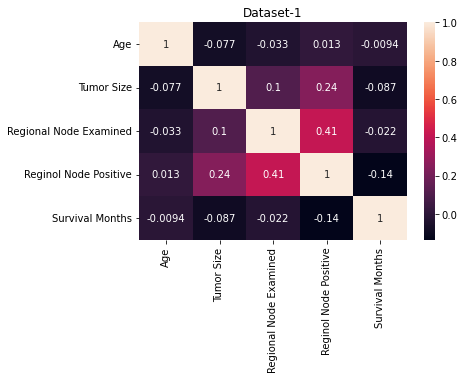

<Figure size 1080x1080 with 0 Axes>

In [14]:
heat_map(df_1, 'Dataset-1', figsize=(15,15))

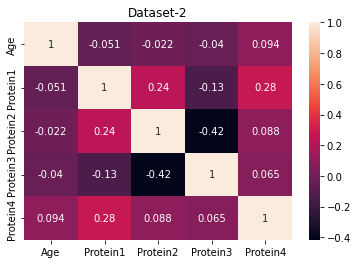

<Figure size 1080x1080 with 0 Axes>

In [15]:
heat_map(df_2, 'Dataset-2', figsize=(15,15))

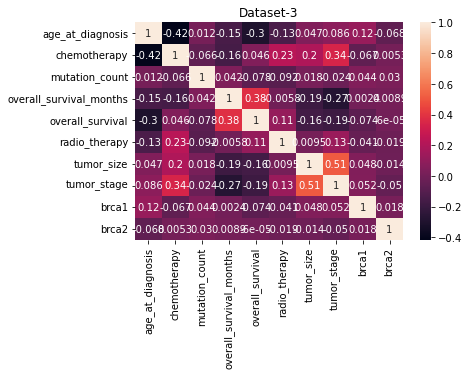

<Figure size 1296x1080 with 0 Axes>

In [16]:
heat_map(df_3, 'Dataset-3', figsize=(18,15))

Text(0.5, 1.0, 'Dataset-4')

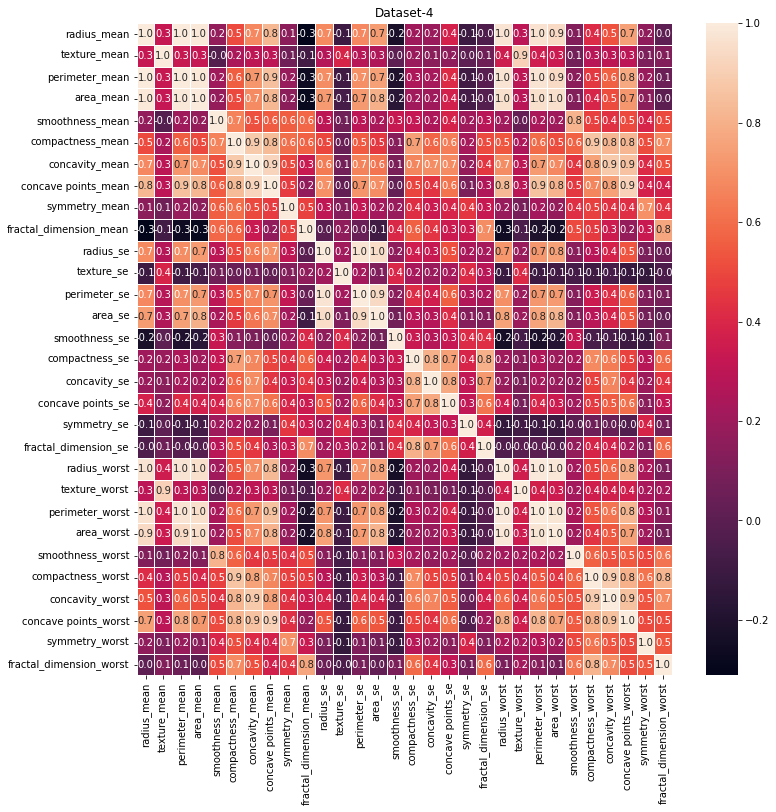

In [17]:
f,ax = plt.subplots(figsize=(12, 12))
sns.heatmap(df_4.corr(), annot=True, ax=ax, linewidths=.5, fmt='.1f')
ax.set_title('Dataset-4')

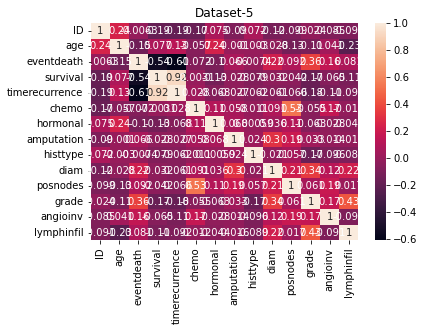

<Figure size 1296x1080 with 0 Axes>

In [18]:
heat_map(df_5, 'Dataset-5', figsize=(18,15))

<AxesSubplot:xlabel='Protein1', ylabel='Protein2'>

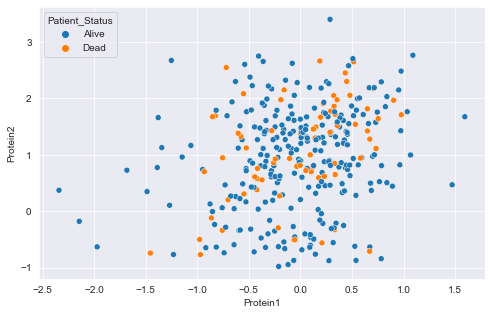

In [25]:
# Corelation between tumour size and survival months affect on different ethnicity
plt.figure(figsize=(8,5))
sns.scatterplot(x = 'Protein1', y = 'Protein2', hue='Patient_Status', data=df_2)

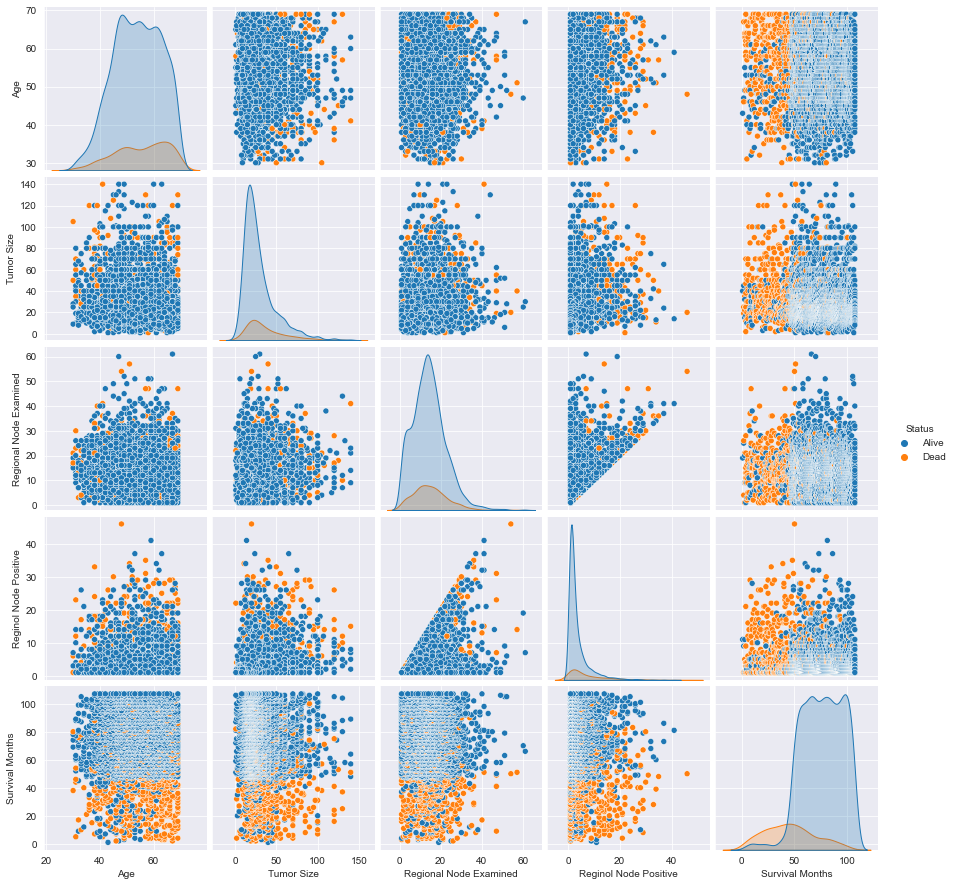

In [20]:
# sns.set_theme(style="ticks")
sns.set_style("darkgrid")
sns.pairplot(df_1, hue="Status")

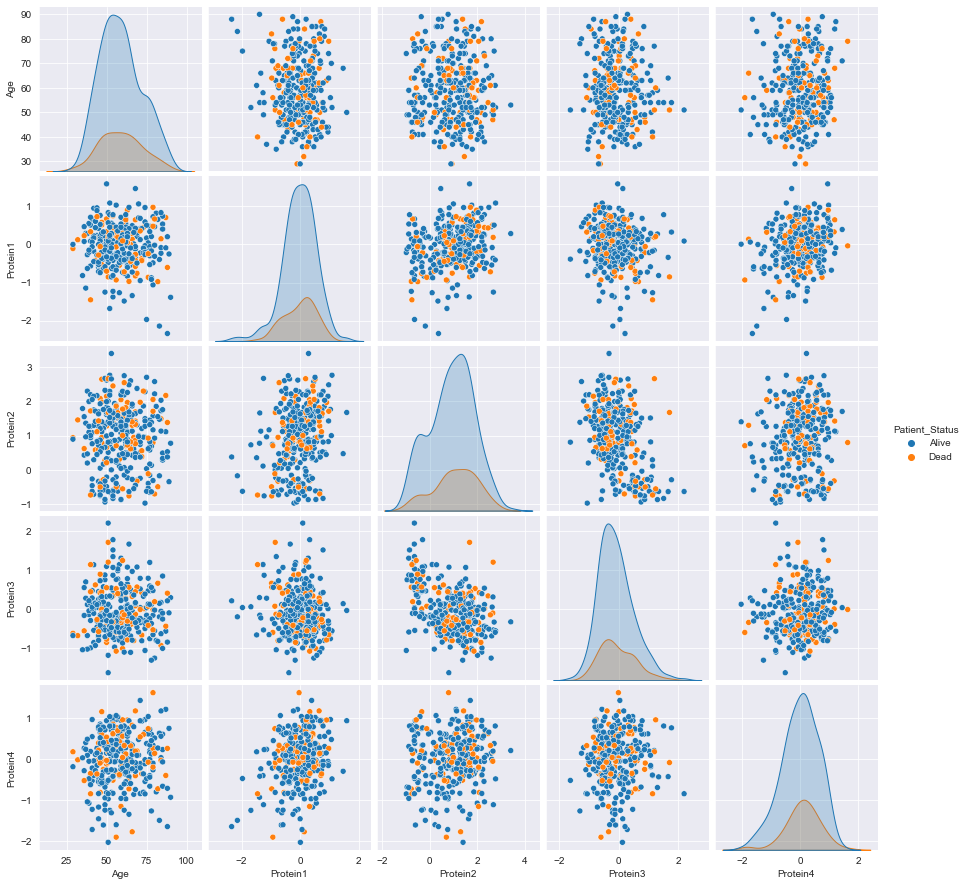

In [21]:
sns.set_style("darkgrid")
sns.pairplot(df_2, hue="Patient_Status")

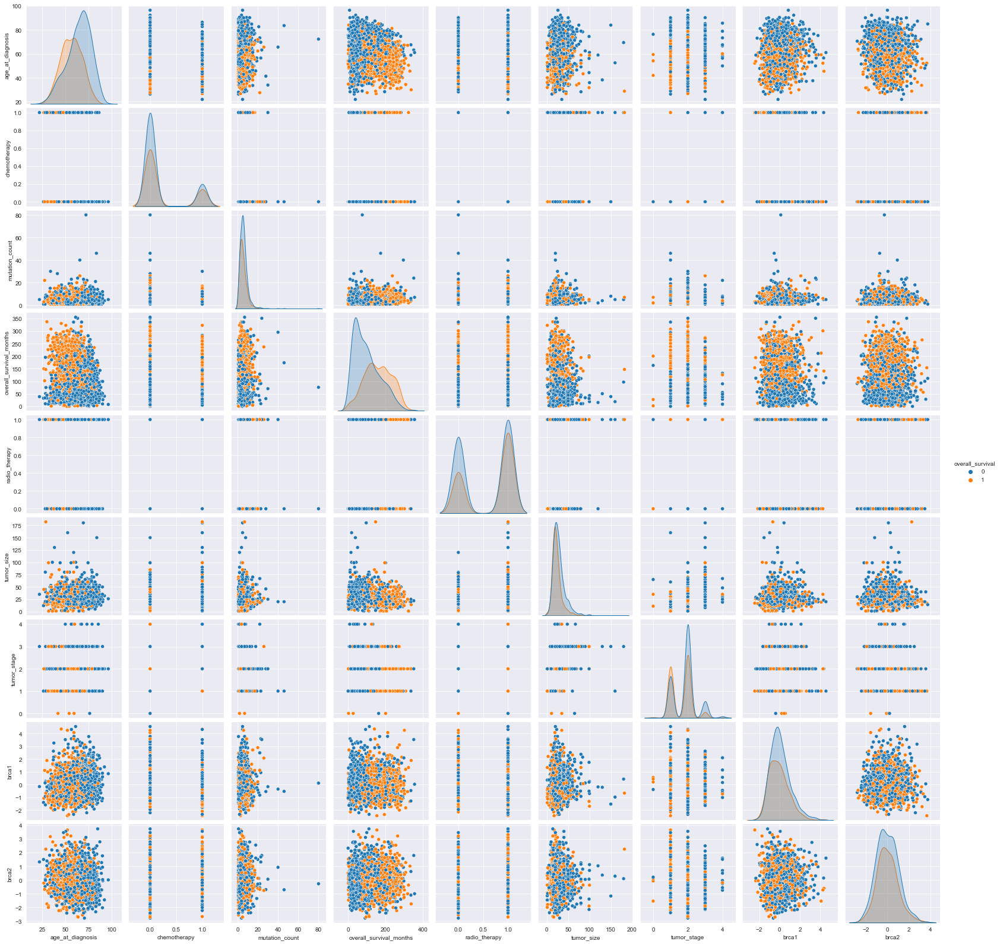

In [22]:
sns.set_style("darkgrid")
sns.pairplot(df_3, hue="overall_survival")

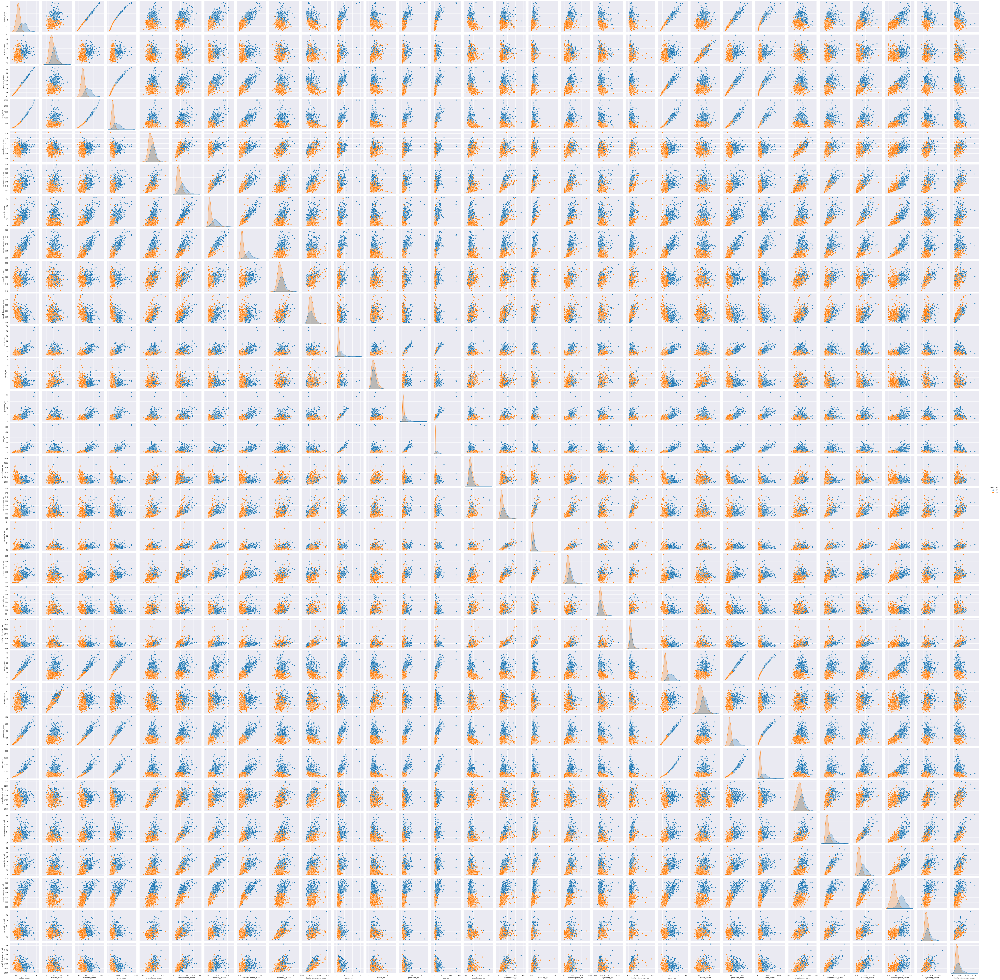

In [23]:
sns.set_style("darkgrid")
sns.pairplot(df_4, hue="diagnosis")

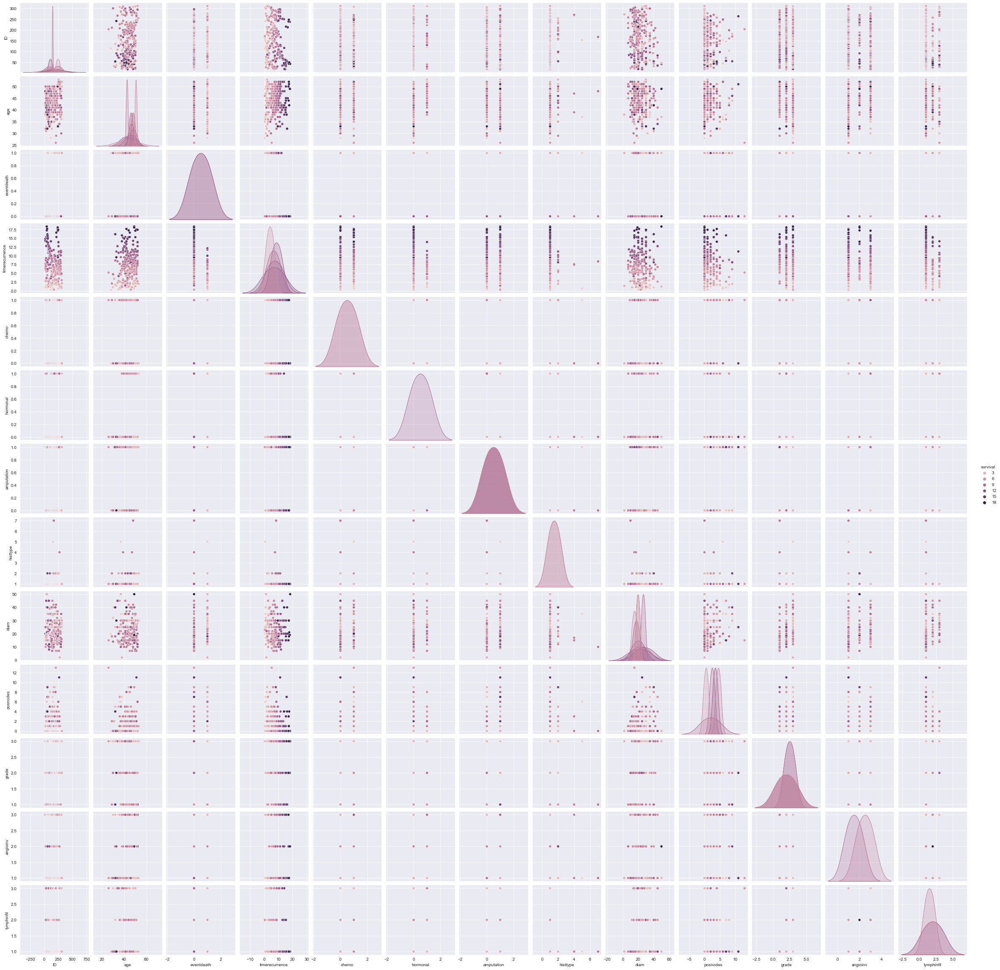

In [27]:
sns.set_style("darkgrid")
sns.pairplot(df_5, hue="survival")

In [29]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4024 entries, 0 to 4023
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   Age                     4024 non-null   int64 
 1   Race                    4024 non-null   object
 2   Marital Status          4024 non-null   object
 3   T Stage                 4024 non-null   object
 4   N Stage                 4024 non-null   object
 5   6th Stage               4024 non-null   object
 6   Grade                   4024 non-null   object
 7   A Stage                 4024 non-null   object
 8   Tumor Size              4024 non-null   int64 
 9   Estrogen Status         4024 non-null   object
 10  Progesterone Status     4024 non-null   object
 11  Regional Node Examined  4024 non-null   int64 
 12  Reginol Node Positive   4024 non-null   int64 
 13  Survival Months         4024 non-null   int64 
 14  Status                  4024 non-null   object
dtypes: i

<AxesSubplot:xlabel='N Stage', ylabel='Age'>

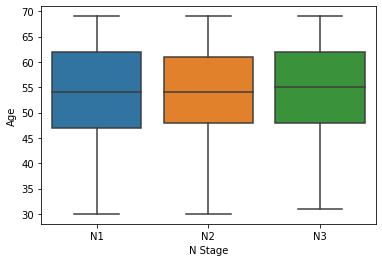

In [21]:
sns.boxplot(data=dataset, x='N Stage', y='Age')

In [32]:
sns.boxplot(data=df_1, x='Race', y='Age')

ValueError: Could not interpret input 'Race'

<AxesSubplot:xlabel='6th Stage', ylabel='Age'>

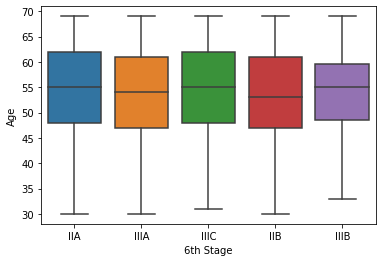

In [22]:
sns.boxplot(data=dataset, x='6th Stage', y='Age')

<AxesSubplot:xlabel='Status', ylabel='Survival Months'>

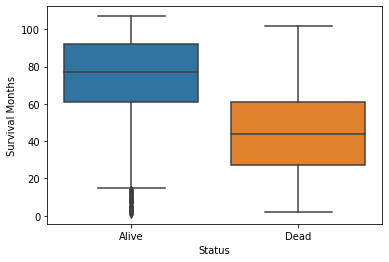

In [55]:
# Boxplot for survival months and patients status
sns.boxplot(data=dataset, x='Status', y='Survival Months')

In [11]:
# Null values in the dataset
dataset.isnull().sum()

Age                       0
Race                      0
Marital Status            0
T Stage                   0
N Stage                   0
6th Stage                 0
differentiate             0
Grade                     0
A Stage                   0
Tumor Size                0
Estrogen Status           0
Progesterone Status       0
Regional Node Examined    0
Reginol Node Positive     0
Survival Months           0
Status                    0
dtype: int64

<AxesSubplot:xlabel='Status', ylabel='count'>

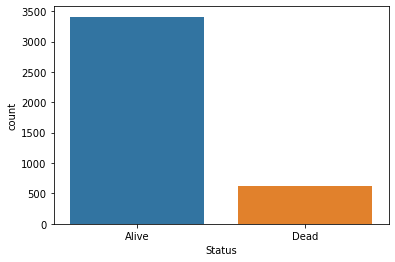

In [57]:
# Graph value
sns.countplot(x='Status', data=dataset)

In [59]:
# Count how many Alive patients
dataset['Status'].value_counts()['Alive']

3408

In [60]:
# Count how many Dead patients
dataset['Status'].value_counts()['Dead']

616

<AxesSubplot:xlabel='Race', ylabel='count'>

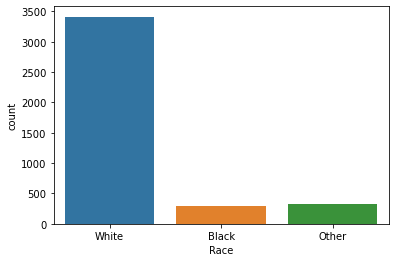

In [67]:
# Count different race from the dataset
# Potentially this dataset can give biased result
sns.countplot(x='Race', data=dataset)

In [366]:
df_1.head()

,Age,Race,Marital Status,T Stage,N Stage,6th Stage,Grade,A Stage,Tumor Size,Estrogen Status,Progesterone Status,Regional Node Examined,Reginol Node Positive,Survival Months,Status
0,13,1,1,1,2,4,0,1,39,1,1,18,10,0,0
1,17,1,1,1,1,2,0,1,44,1,1,24,8,1,0
2,37,2,1,1,0,1,1,1,24,1,1,3,0,1,1
3,16,2,0,0,0,0,0,1,18,1,1,25,0,1,1
4,33,2,1,1,1,2,0,1,34,1,1,20,4,2,1


In [374]:
# Check the x and y axis labels and change if necessary 
px.scatter(x='Age', y='Tumor Size', data_frame=df_1)

<AxesSubplot:xlabel='Age', ylabel='Density'>

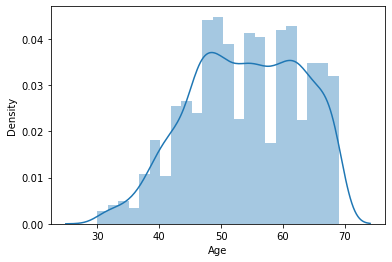

In [78]:
# Identify age group using distplot
sns.distplot(df_.Age, kde=True)

<AxesSubplot:xlabel='Protein2', ylabel='Density'>

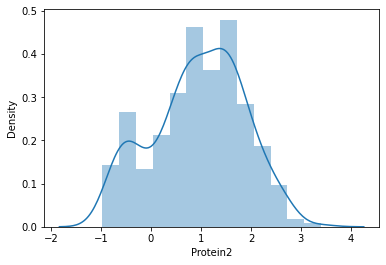

In [16]:
sns.distplot(dataset.Protein2, kde=True)

<AxesSubplot:xlabel='Protein3', ylabel='Density'>

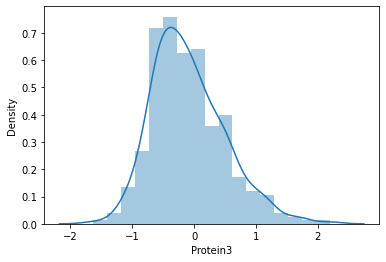

In [17]:
sns.distplot(dataset.Protein3, kde=True)

<AxesSubplot:xlabel='Age', ylabel='Density'>

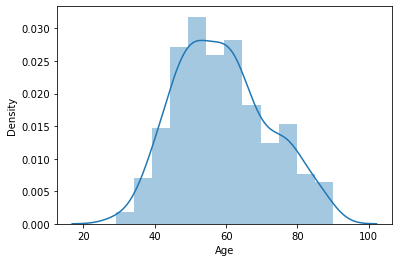

In [18]:
sns.distplot(dataset.Age, kde=True)

In [34]:
# Check again to make sure there is no NaN values
df_1.isnull().sum()

Age                       0
Race                      0
Marital Status            0
T Stage                   0
N Stage                   0
6th Stage                 0
Grade                     0
A Stage                   0
Tumor Size                0
Estrogen Status           0
Progesterone Status       0
Regional Node Examined    0
Reginol Node Positive     0
Survival Months           0
Status                    0
dtype: int64

In [37]:
df_1.head()

,Age,Race,Marital Status,T Stage,N Stage,6th Stage,Grade,A Stage,Tumor Size,Estrogen Status,Progesterone Status,Regional Node Examined,Reginol Node Positive,Survival Months,Status
0,13,1,1,1,2,4,0,1,39,1,1,18,10,0,0
1,17,1,1,1,1,2,0,1,44,1,1,24,8,1,0
2,37,2,1,1,0,1,1,1,24,1,1,3,0,1,1
3,16,2,0,0,0,0,0,1,18,1,1,25,0,1,1
4,33,2,1,1,1,2,0,1,34,1,1,20,4,2,1


In [98]:
# Due to 5 datasets used in the implementation of this project
# I have used "df" as the common name hereafter, uncommented the one needs to test from below list
# df_3 = df_3.sample(frac=1)


# df = df_1
# df = df_2
# df = df_3
# df = df_4
df = df_5

In [99]:
le = preprocessing.LabelEncoder()
for i in df.columns:
    df[i] = le.fit_transform(df[i])
    print(df)


# dataset['Patient_Status'] = le.fit_transform(dataset['Patient_Status'])

     Patient   ID  age  eventdeath   survival  timerecurrence  chemo  \
0          8   18   43           0  14.817248       14.817248      0   
1          9   19   48           0  14.261465       14.261465      0   
2         10   20   38           0   6.644764        6.644764      0   
3         11   21   50           0   7.748118        7.748118      0   
4         12   22   38           0   6.436687        6.318960      0   
..       ...  ...  ...         ...        ...             ...    ...   
267      265  308   48           1   2.608300        1.982204      1   
268      266  309   39           1   5.504100        3.028063      0   
269      267  310   50           1   2.619200        2.149213      0   
270      268  311   52           1   2.290500        2.209446      0   
271      269  312   52           1   3.737000        2.127310      0   

     hormonal  amputation  histtype  diam  posnodes  grade  angioinv  \
0           0           1         1    25         0      2     

In [100]:
# Split the dataset into training and testing
# y = dataset.pop('Status').values

# For dataset-1
# X = df.drop('Status', axis=1)
# y = df['Status']

# For dataset-2
# X = df.drop('Patient_Status', axis=1)
# y = df['Patient_Status']

# For dataset-3
# X = df.drop('overall_survival', axis=1)
# y = df['overall_survival']

# For dataset-4
# X = df.drop('diagnosis', axis=1)
# y = df['diagnosis']

# # For dataset-5
X = df.drop('eventdeath', axis=1)
y = df['eventdeath']

X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.5, random_state=50)

In [101]:
# Standard Scaler
sc = StandardScaler()

# Fit to the train dataset
X_train = sc.fit_transform(X_train) 
X_test = sc.transform(X_test)

In [102]:
# Random Forest Classifier model
rf_model= RandomForestClassifier(n_estimators=600, random_state=4)

rf_model.fit(X_train, y_train)

y_pred_rf = rf_model.predict(X_test)

print('Accuracy_score: ', accuracy_score(y_test, y_pred_rf))
print('Precision_score: ', precision_score(y_test, y_pred_rf,average='macro'))
print('Recall_score: ', recall_score(y_test, y_pred_rf, average='macro'))
print('F1_score: ', f1_score(y_test, y_pred_rf, average='macro'))

Accuracy_score:  0.8897058823529411
Precision_score:  0.9169369369369369
Recall_score:  0.8106874328678839
F1_score:  0.8450672134882661


In [80]:
# classification report
print(classification_report(y_test, y_pred_rf))

              precision    recall  f1-score   support

           0       0.78      0.96      0.86        98
           1       0.75      0.32      0.44        38

    accuracy                           0.78       136
   macro avg       0.77      0.64      0.65       136
weighted avg       0.77      0.78      0.75       136



In [81]:
# SVM Model with linear kernel 
svc_model = SVC(kernel ='linear')
svc_model.fit(X_train, y_train)
y_pred_svc = svc_model.predict(X_test)


print('Accuracy_score: ', accuracy_score(y_test, y_pred_svc))
print('Precision_score: ', precision_score(y_test, y_pred_svc, average='macro'))
print('Recall_score: ', recall_score(y_test, y_pred_svc, average='macro'))
print('F1_score: ', f1_score(y_test, y_pred_svc, average='macro'))

Accuracy_score:  0.7279411764705882
Precision_score:  0.6473873873873874
Recall_score:  0.609828141783029
F1_score:  0.6178324599377231


In [82]:
print(classification_report(y_test, y_pred_svc))

              precision    recall  f1-score   support

           0       0.77      0.88      0.82        98
           1       0.52      0.34      0.41        38

    accuracy                           0.73       136
   macro avg       0.65      0.61      0.62       136
weighted avg       0.70      0.73      0.71       136



In [83]:
# SVM Model with poly kernel 
svc_model_poly = SVC(kernel ='poly', degree=2, C=10)
svc_model_poly.fit(X_train, y_train)
y_pred_poly = svc_model_poly.predict(X_test)


print('Accuracy_score: ', accuracy_score(y_test, y_pred_poly))
print('Precision_score: ', precision_score(y_test, y_pred_poly, average='macro'))
print('Recall_score: ', recall_score(y_test, y_pred_poly, average='macro'))
print('F1_score: ', f1_score(y_test, y_pred_poly, average='macro'))

Accuracy_score:  0.7352941176470589
Precision_score:  0.6730158730158731
Recall_score:  0.5585392051557465
F1_score:  0.5446428571428572


In [84]:
print(classification_report(y_test, y_pred_poly))

              precision    recall  f1-score   support

           0       0.75      0.96      0.84        98
           1       0.60      0.16      0.25        38

    accuracy                           0.74       136
   macro avg       0.67      0.56      0.54       136
weighted avg       0.71      0.74      0.67       136



In [85]:
# SVM Model with rbf kernel 
svc_model_rbf = SVC(kernel ='rbf', C=10)
svc_model_rbf.fit(X_train, y_train)

y_pred_rbf = svc_model_rbf.predict(X_test)

print('Accuracy_score: ', accuracy_score(y_test, y_pred_rbf))
print('Precision_score: ', precision_score(y_test, y_pred_rbf, average='macro'))
print('Recall_score: ', recall_score(y_test, y_pred_rbf, average='macro'))
print('F1_score: ', f1_score(y_test, y_pred_rbf, average='macro'))

Accuracy_score:  0.7205882352941176
Precision_score:  0.6229508196721312
Recall_score:  0.556390977443609
F1_score:  0.5482517482517483


In [86]:
print(classification_report(y_test, y_pred_rbf))

              precision    recall  f1-score   support

           0       0.75      0.93      0.83        98
           1       0.50      0.18      0.27        38

    accuracy                           0.72       136
   macro avg       0.62      0.56      0.55       136
weighted avg       0.68      0.72      0.67       136



In [103]:
X_train.shape, y_train.shape

((136, 14), (136,))

In [104]:
# Uncomment relevant code when needed to use
# For Dataset-1
# X_train_reshape = np.reshape(X_train, (3219, 14, 1))
# X_test_reshape = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

# For Dataset-2
# X_train_reshape = np.reshape(X_train, (267, 12, 1))
# X_test_reshape = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

# For Dataset-3
# X_train_reshape = np.reshape(X_train, (1523, 17, 1))
# X_test_reshape = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

# For Dataset-4
# X_train_reshape = np.reshape(X_train, (426, 30, 1))
# X_test_reshape = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

# For Dataset-5
X_train_reshape = np.reshape(X_train, (136, 14, 1))
X_test_reshape = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

In [105]:
X_train_reshape.shape


(136, 14, 1)

In [106]:
X_test_reshape.shape

(136, 14, 1)

In [107]:
# CNN model
from keras.models import Sequential 
from keras.layers import Conv1D, MaxPooling1D, Flatten, Dense

# Create the model
model = Sequential()

# 1D convolutional layer with 32 filters and a kernel size of 3
# for dataset-1
# model.add(Conv1D(32,3, input_shape=(14,1), activation='relu'))

# for dataset-2
# model.add(Conv1D(32,3, input_shape=(12,1), activation='relu'))

# for dataset-3
# model.add(Conv1D(32,3, input_shape=(17,1), activation='relu'))

# for dataset-4
# model.add(Conv1D(32,3, input_shape=(30,1), activation='relu'))

# for dataset-5
model.add(Conv1D(32,3, input_shape=(14,1), activation='relu'))

# MaxPooling layer with a pool size of2
model.add(MaxPooling1D(2))

# Another convolutional layer with 64 filters and a kernel size of 3
model.add(Conv1D(64,3, activation='relu'))
model.add(MaxPooling1D(2))
# Flattening layer
model.add(Flatten())
# Fully connected layer with 64 units and ReLU activation function
model.add(Dense(64, activation='relu'))
# Output layer with sigmoid activation function
model.add(Dense(1, activation='sigmoid'))

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_4 (Conv1D)           (None, 12, 32)            128       
                                                                 
 max_pooling1d_4 (MaxPooling  (None, 6, 32)            0         
 1D)                                                             
                                                                 
 conv1d_5 (Conv1D)           (None, 4, 64)             6208      
                                                                 
 max_pooling1d_5 (MaxPooling  (None, 2, 64)            0         
 1D)                                                             
                                                                 
 flatten_3 (Flatten)         (None, 128)               0         
                                                                 
 dense_6 (Dense)             (None, 64)               

In [109]:
# Train the model
history = model.fit(X_train_reshape, y_train, epochs=10, validation_data=(X_test_reshape, y_test))

Epoch 1/10
5/5 [==============================] - 0s 15ms/step - loss: 0.5872 - accuracy: 0.7132 - val_loss: 0.5662 - val_accuracy: 0.7206
Epoch 2/10
5/5 [==============================] - 0s 9ms/step - loss: 0.5422 - accuracy: 0.7132 - val_loss: 0.5345 - val_accuracy: 0.7206
Epoch 3/10
5/5 [==============================] - 0s 7ms/step - loss: 0.4904 - accuracy: 0.7132 - val_loss: 0.4980 - val_accuracy: 0.7647
Epoch 4/10
5/5 [==============================] - 0s 9ms/step - loss: 0.4378 - accuracy: 0.8456 - val_loss: 0.4627 - val_accuracy: 0.8015
Epoch 5/10
5/5 [==============================] - 0s 9ms/step - loss: 0.3895 - accuracy: 0.8676 - val_loss: 0.4338 - val_accuracy: 0.8162
Epoch 6/10
5/5 [==============================] - 0s 9ms/step - loss: 0.3450 - accuracy: 0.9044 - val_loss: 0.4101 - val_accuracy: 0.8162
Epoch 7/10
5/5 [==============================] - 0s 9ms/step - loss: 0.3055 - accuracy: 0.9191 - val_loss: 0.3989 - val_accuracy: 0.8235
Epoch 8/10
5/5 [=================

In [39]:
# Evaluate the model on the test result
test_loss, test_acc = model.evaluate(X_test_reshape, y_test)
print('Test accuracy: ', test_acc)

157/157 [==============================] - 0s 1ms/step - loss: 0.0793 - accuracy: 0.9702
Test accuracy:  0.9702000021934509


In [40]:
# Build the neural network 
dnn_model = keras.Sequential([
    
#     for dataset-1
#     keras.layers.Flatten(input_shape=(14,)),
    
#     for dataset-2
#     keras.layers.Flatten(input_shape=(12,)),
    
#     for dataset-3
#     keras.layers.Flatten(input_shape=(17,)),

    #     for dataset-4
#     keras.layers.Flatten(input_shape=(30,)),
    
    #     for dataset-5
    keras.layers.Flatten(input_shape=(14,)),    
    
    keras.layers.Dense(5, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])

dnn_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [41]:
# Train the model
dnn_model.fit(X_train, y_train, epochs=20, batch_size=32, validation_data=(X_test, y_test))

Epoch 1/20
157/157 [==============================] - 1s 3ms/step - loss: 0.4912 - accuracy: 0.7530 - val_loss: 0.2708 - val_accuracy: 0.8810
Epoch 2/20
157/157 [==============================] - 0s 2ms/step - loss: 0.2123 - accuracy: 0.9184 - val_loss: 0.1724 - val_accuracy: 0.9302
Epoch 3/20
157/157 [==============================] - 0s 2ms/step - loss: 0.1431 - accuracy: 0.9416 - val_loss: 0.1313 - val_accuracy: 0.9504
Epoch 4/20
157/157 [==============================] - 0s 2ms/step - loss: 0.1089 - accuracy: 0.9656 - val_loss: 0.1078 - val_accuracy: 0.9664
Epoch 5/20
157/157 [==============================] - 0s 2ms/step - loss: 0.0884 - accuracy: 0.9736 - val_loss: 0.0926 - val_accuracy: 0.9680
Epoch 6/20
157/157 [==============================] - 0s 2ms/step - loss: 0.0759 - accuracy: 0.9762 - val_loss: 0.0835 - val_accuracy: 0.9732
Epoch 7/20
157/157 [==============================] - 0s 2ms/step - loss: 0.0675 - accuracy: 0.9804 - val_loss: 0.0768 - val_accuracy: 0.9790
Epoch 

In [72]:
# Decision Tree model

from sklearn.tree import DecisionTreeClassifier

dt_model = DecisionTreeClassifier(random_state=80)

dt_model = dt_model.fit(X_train, y_train)

y_predic_dt = dt_model.predict(X_test)


In [43]:
print('Accuracy_score: ', accuracy_score(y_test, y_predic_dt))
print('Precision_score: ', precision_score(y_test, y_predic_dt, average='macro'))
print('Recall_score: ', recall_score(y_test, y_predic_dt, average='macro'))
print('F1_score: ', f1_score(y_test, y_predic_dt, average='macro'))

Accuracy_score:  0.9974
Precision_score:  0.9964383561643836
Recall_score:  0.997961104140527
F1_score:  0.9971912820332665


In [44]:
print(classification_report(y_test, y_predic_dt))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      3188
           1       0.99      1.00      1.00      1812

    accuracy                           1.00      5000
   macro avg       1.00      1.00      1.00      5000
weighted avg       1.00      1.00      1.00      5000



In [110]:
# K-Nearset Neighbor
from sklearn.neighbors import KNeighborsClassifier


knn_model = KNeighborsClassifier()
knn_model = knn_model.fit(X_train, y_train)

y_predic_knn = knn_model.predict(X_test)

print('Accuracy_score: ', accuracy_score(y_test, y_predic_knn))
print('Precision_score: ', precision_score(y_test, y_predic_knn, average='macro'))
print('Recall_score: ', recall_score(y_test, y_predic_knn, average='macro'))
print('F1_score: ', f1_score(y_test, y_predic_knn, average='macro'))

Accuracy_score:  0.8382352941176471
Precision_score:  0.8484848484848485
Recall_score:  0.7346938775510203
F1_score:  0.7647798742138364


In [46]:
print(classification_report(y_test, y_predic_knn))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      3188
           1       0.99      0.99      0.99      1812

    accuracy                           0.99      5000
   macro avg       0.99      0.99      0.99      5000
weighted avg       0.99      0.99      0.99      5000



In [47]:
# Logistic Regression
from sklearn.linear_model import LogisticRegression


lr_model = LogisticRegression(C=1e5)
lr_model = lr_model.fit(X_train, y_train)

y_predic_lr = lr_model.predict(X_test)

print('Accuracy_score: ', accuracy_score(y_test, y_predic_lr))
print('Precision_score: ', precision_score(y_test, y_predic_lr, average='macro'))
print('Recall_score: ', recall_score(y_test, y_predic_lr, average='macro'))
print('F1_score: ', f1_score(y_test, y_predic_lr, average='macro'))

Accuracy_score:  0.9874
Precision_score:  0.9874727637587256
Recall_score:  0.9852360950695351
F1_score:  0.9863364127010634


In [363]:
print(classification_report(y_test, y_predic_lr))

              precision    recall  f1-score   support

           0       0.87      0.87      0.87        45
           1       0.74      0.74      0.74        23

    accuracy                           0.82        68
   macro avg       0.80      0.80      0.80        68
weighted avg       0.82      0.82      0.82        68



In [112]:
# Hybrid model using KNN and RF 
rf_probs = rf_model.predict_proba(X_test)
knn_probs = knn_model.predict_proba(X_test)
hybrid_predic = (0.5 * knn_probs) + (0.5 * rf_probs)

In [118]:
y_test.value

AttributeError: 'Series' object has no attribute 'value'

In [114]:
from sklearn.metrics import precision_recall_fscore_support




accuracy = accuracy_score(y_test, hybrid_predic)
precision, recall, f1, _ = precision_recall_fscore_support(y_test, hybrid_predic, average='weighted')

# print('Hybrid model accuracy: ', accuracy)
print('Hybrid model precision:', precision)
print('Hybrid model recall:', recall)
print('Hybrid model F1 score:', f1)

ValueError: Classification metrics can't handle a mix of binary and continuous-multioutput targets

In [63]:
# Cross Validation using 5 Fold
kfold_validation=KFold(5)

kfold_dt = cross_val_score(dt_model,X,y,cv=kfold_validation)
kfold_lr = cross_val_score(lr_model,X,y,cv=kfold_validation)
kfold_knn = cross_val_score(knn_model,X,y,cv=kfold_validation)
kfold_rf = cross_val_score(rf_model,X,y,cv=kfold_validation)
kfold_svc = cross_val_score(svc_model,X,y,cv=kfold_validation)


# print(kfold_dt)
print('Decision Tree K-Fold 5:', np.mean(kfold_dt))
print('')
print('Logistic Regression K-Fold 5:', np.mean(kfold_lr))
print('')
print('K-Nearest Neighbor K-Fold 5:', np.mean(kfold_knn))
print('')
print('Random Forest K-Fold 5:', np.mean(kfold_rf))
print('')
print('Support Vector Machine K-Fold 5:', np.mean(kfold_svc))

Decision Tree K-Fold 5: 0.9

Logistic Regression K-Fold 5: 0.8

K-Nearest Neighbor K-Fold 5: 0.7

Random Forest K-Fold 5: 0.7

Support Vector Machine K-Fold 5: 0.8
Testing time: -773.76 seconds


In [345]:
# Cross Validation using 10 Fold
kfold_validation=KFold(10)

kfold_dt = cross_val_score(dt_model,X,y,cv=kfold_validation)
kfold_lr = cross_val_score(lr_model,X,y,cv=kfold_validation)
kfold_knn = cross_val_score(knn_model,X,y,cv=kfold_validation)
kfold_rf = cross_val_score(rf_model,X,y,cv=kfold_validation)
kfold_svc = cross_val_score(svc_model,X,y,cv=kfold_validation)

# print(kfold_dt)
print('Decision Tree K-Fold 10:', np.mean(kfold_dt))
print('')
print('Logistic Regression K-Fold 10:', np.mean(kfold_lr))
print('')
print('K-Nearest Neighbor K-Fold 10:', np.mean(kfold_knn))
print('')
print('Random Forest K-Fold 10:', np.mean(kfold_rf))
print('')
print('Support Vector Machine K-Fold 10:', np.mean(kfold_svc))

Decision Tree K-Fold 10: 0.8244708994708996

Logistic Regression K-Fold 10: 0.871164021164021

K-Nearest Neighbor K-Fold 10: 0.8281746031746031

Random Forest K-Fold 10: 0.8970899470899472

Support Vector Machine K-Fold 10: 0.8563492063492063


In [346]:
# Cross Validation using 20 Fold
kfold_validation=KFold(20)

kfold_dt = cross_val_score(dt_model,X,y,cv=kfold_validation)
kfold_lr = cross_val_score(lr_model,X,y,cv=kfold_validation)
kfold_knn = cross_val_score(knn_model,X,y,cv=kfold_validation)
kfold_rf = cross_val_score(rf_model,X,y,cv=kfold_validation)
kfold_svc = cross_val_score(svc_model,X,y,cv=kfold_validation)

# print(kfold_dt)
print('Decision Tree K-Fold 20:', np.mean(kfold_dt))
print('')
print('Logistic Regression K-Fold 20:', np.mean(kfold_lr))
print('')
print('K-Nearest Neighbor K-Fold 20:', np.mean(kfold_knn))
print('')
print('Random Forest K-Fold 20:', np.mean(kfold_rf))
print('')
print('Support Vector Machine K-Fold 20:', np.mean(kfold_svc))

Decision Tree K-Fold 20: 0.8206043956043956

Logistic Regression K-Fold 20: 0.8549450549450549

K-Nearest Neighbor K-Fold 20: 0.851923076923077

Random Forest K-Fold 20: 0.8961538461538462

Support Vector Machine K-Fold 20: 0.8741758241758243
